In [1]:
%%capture
# Update kaggle-environments to the newest version.
!pip3 install kaggle-environments -U

# GFootball environment.
!apt-get update -y
!apt-get install -y libsdl2-gfx-dev libsdl2-ttf-dev

# Make sure that the Branch in git clone and in wget call matches !!
!git clone -b v2.7 https://github.com/google-research/football.git
!mkdir -p football/third_party/gfootball_engine/lib

!wget https://storage.googleapis.com/gfootball/prebuilt_gameplayfootball_v2.7.so -O football/third_party/gfootball_engine/lib/prebuilt_gameplayfootball.so
!cd football && GFOOTBALL_USE_PREBUILT_SO=1 pip3 install .

## Install

In [2]:
%%capture
!pip install pfrl==0.1.0

In [3]:
import os
import cv2
import sys
import glob 
import random
import imageio
import pathlib
import collections
from collections import deque
import numpy as np
import argparse
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
%matplotlib inline

from gym import spaces
from tqdm import tqdm
from logging import getLogger, StreamHandler, FileHandler, DEBUG, INFO
from typing import Union, Callable, List, Tuple, Iterable, Any, Dict
from dataclasses import dataclass
from IPython.display import Image, display
sns.set()


# PyTorch
import pfrl
from pfrl.agents import CategoricalDoubleDQN
from pfrl import experiments
from pfrl import explorers
from pfrl import nn as pnn
from pfrl import utils
from pfrl import replay_buffers
from pfrl.wrappers import atari_wrappers
from pfrl.q_functions import DistributionalDuelingDQN

import torch
from torch import nn

# Env
import gym
import gfootball
import gfootball.env as football_env
from gfootball.env import observation_preprocessing

## Config

In [4]:
# Check we can use GPU
print(torch.cuda.is_available())

# set gpu id
if torch.cuda.is_available(): 
    # NOTE: it is not number of gpu but id which start from 0
    gpu = 0
else:
    # cpu=>-1
    gpu = -1

True


In [5]:
# set logger
def logger_config():
    logger = getLogger(__name__)
    handler = StreamHandler()
    handler.setLevel("DEBUG")
    logger.setLevel("DEBUG")
    logger.addHandler(handler)
    logger.propagate = False

    filepath = './result.log'
    file_handler = FileHandler(filepath)
    logger.addHandler(file_handler)
    return logger

logger = logger_config()

In [6]:
# fixed random seed
# but this is NOT enough to fix the result of rewards.Please tell me the reason.
def seed_everything(seed=1234):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    utils.set_random_seed(seed)  # for PFRL
    
# Set a random seed used in PFRL.
seed = 5046
seed_everything(seed)

# Set different random seeds for train and test envs.
train_seed = seed
test_seed = 2 ** 31 - 1 - seed

## Environment

In [7]:
# wrapper for env(resize and transpose channel order)
class TransEnv(gym.ObservationWrapper):
    def __init__(self, env, channel_order="hwc"):

        gym.ObservationWrapper.__init__(self, env)
        self.height = 84
        self.width = 84
        self.ch = env.observation_space.shape[2]
        shape = {
            "hwc": (self.height, self.width, self.ch),
            "chw": (self.ch, self.height, self.width),
        }
        self.observation_space = spaces.Box(
            low=0, high=255, shape=shape[channel_order], dtype=np.uint8
        )
        

    def observation(self, frame):
        frame = cv2.resize(frame, (self.width, self.height), interpolation=cv2.INTER_AREA)
        return frame.reshape(self.observation_space.low.shape)

In [8]:
def make_env(test):
    # Use different random seeds for train and test envs
    env_seed = test_seed if test else train_seed
    
    # env = gym.make('GFootball-11_vs_11_kaggle-SMM-v0')
    env = football_env.create_environment(
      env_name='11_vs_11_easy_stochastic',  # easy mode
      stacked=False,
      representation='extracted',  # SMM
      rewards='scoring,checkpoints',
      write_goal_dumps=False,
      write_full_episode_dumps=False,
      render=False,
      write_video=False,
      dump_frequency=1,
      logdir='./',
      extra_players=None,
      number_of_left_players_agent_controls=1,
      number_of_right_players_agent_controls=0
    )
    env = TransEnv(env, channel_order="chw")

    env.seed(int(env_seed))
    if test:
        # Randomize actions like epsilon-greedy in evaluation as well
        env = pfrl.wrappers.RandomizeAction(env, random_fraction=0.0)
    return env

env = make_env(test=False)
eval_env = make_env(test=True)

In [9]:
print('observation space:', env.observation_space.low.shape)
print('action space:', env.action_space)

observation space: (4, 84, 84)
action space: Discrete(19)


In [10]:
env.reset()
action = env.action_space.sample()
obs, r, done, info = env.step(action)
print('next observation:', obs.shape)
print('reward:', r)
print('done:', done)
print('info:', info)

next observation: (4, 84, 84)
reward: 0.0
done: False
info: {'score_reward': 0}


## Model

In [11]:
obs_n_channels = env.observation_space.low.shape[0]
n_actions = env.action_space.n
print("obs_n_channels: ", obs_n_channels)
print("n_actions: ", n_actions)

# params based the original paper
n_atoms = 51
v_max = 10
v_min = -10
q_func = DistributionalDuelingDQN(n_actions, n_atoms, v_min, v_max, obs_n_channels)
print(q_func)

obs_n_channels:  4
n_actions:  19
DistributionalDuelingDQN(
  (conv_layers): ModuleList(
    (0): Conv2d(4, 32, kernel_size=(8, 8), stride=(4, 4))
    (1): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2))
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
  )
  (main_stream): Linear(in_features=3136, out_features=1024, bias=True)
  (a_stream): Linear(in_features=512, out_features=969, bias=True)
  (v_stream): Linear(in_features=512, out_features=51, bias=True)
)


In [12]:
# Noisy nets
pnn.to_factorized_noisy(q_func, sigma_scale=0.5)

# Turn off explorer
explorer = explorers.Greedy()

# Use the same hyper parameters as https://arxiv.org/abs/1710.02298
opt = torch.optim.Adam(q_func.parameters(), 6.25e-5, eps=1.5 * 10 ** -4)

# Prioritized Replay
# Anneal beta from beta0 to 1 throughout training
update_interval = 4
betasteps = 5 * 10 ** 7 / update_interval
rbuf = replay_buffers.PrioritizedReplayBuffer(
        10 ** 5 * 2,  # Default value is 10 ** 6 but it is too large in this notebook. I chose 10 ** 5.
        alpha=0.5,
        beta0=0.4,
        betasteps=betasteps,
        num_steps=3,
        normalize_by_max="memory",
    )


def phi(x):
    # Feature extractor
    return np.asarray(x, dtype=np.float32) / 255

In [13]:
agent = CategoricalDoubleDQN(
        q_func,
        opt,
        rbuf,
        gpu=gpu,  
        gamma=0.99,
        explorer=explorer,
        minibatch_size=32,
        replay_start_size=2 * 10 ** 4,
        target_update_interval=32000,
        update_interval=update_interval,
        batch_accumulator="mean",
        phi=phi,
    )

In [14]:
# if you have a pretrained model, agent can load pretrained weight. 
use_pretrained = False
pretrained_path = None
if use_pretrained:
    agent.load(pretrained_path)

## Train

In this notebook, I set 100K steps to reduce processing times(spend about 1 hour).    
To improve the agent, we will need to try following.
- set high value steps & high value replay buffers
- add some innovations 
- use other RL agent

In [15]:
#num_steps = 1000000
num_steps = 800000

In [16]:
%%time
experiments.train_agent_with_evaluation(
    agent=agent,
    env=env,
    steps=num_steps,
    eval_n_steps=None,
    eval_n_episodes=1,
    eval_interval=3000,
    outdir="./",
    checkpoint_freq=100000,
    save_best_so_far_agent=True,
    eval_env=eval_env,
    logger=logger
)

outdir:./ step:3001 episode:0 R:-0.4999999850988388
statistics:[('average_q', nan), ('average_loss', nan), ('cumulative_steps', 3001), ('n_updates', 0), ('rlen', 3001)]
evaluation episode 0 length:3001 R:-1.3999999910593033
The best score is updated -3.4028235e+38 -> -1.3999999910593033
Saved the agent to ./best
outdir:./ step:6002 episode:1 R:2.0000000596046448
statistics:[('average_q', nan), ('average_loss', nan), ('cumulative_steps', 6002), ('n_updates', 0), ('rlen', 6002)]
evaluation episode 0 length:3001 R:-1.2999999821186066
The best score is updated -1.3999999910593033 -> -1.2999999821186066
Saved the agent to ./best
outdir:./ step:9003 episode:2 R:-1.2999999523162842
statistics:[('average_q', nan), ('average_loss', nan), ('cumulative_steps', 9003), ('n_updates', 0), ('rlen', 9003)]
evaluation episode 0 length:3001 R:-0.9999999850988388
The best score is updated -1.2999999821186066 -> -0.9999999850988388
Saved the agent to ./best
outdir:./ step:12004 episode:3 R:-0.4999999850988

CPU times: user 7h 35min 35s, sys: 44.7 s, total: 7h 36min 20s
Wall time: 7h 40min 8s


In [17]:
import csv

def text_csv_converter(datas):
    file_csv = datas.replace("txt", "csv")
    with open(datas) as rf:
        with open(file_csv, "w") as wf:
            readfile = rf.readlines()
            for read_text in readfile:
                read_text = read_text.split()
                writer = csv.writer(wf, delimiter=',')
                writer.writerow(read_text)

filename = "scores.txt"
text_csv_converter(filename)

In [18]:
import pandas as pd
scores = pd.read_csv("scores.csv")
scores.tail()

,steps,episodes,elapsed,mean,median,stdev,max,min,average_q,average_loss,cumulative_steps,n_updates,rlen
261,786262,262,27175.122569,2.0,2.0,0.0,2.0,2.0,NaN,3.283926,786262,191565,200000
262,789263,263,27274.652139,0.7,0.7,0.0,0.7,0.7,NaN,3.284544,789263,192315,200000
263,792264,264,27374.664268,2.0,2.0,0.0,2.0,2.0,NaN,3.284166,792264,193066,200000
264,795265,265,27473.062462,-0.2,-0.2,0.0,-0.2,-0.2,NaN,3.283590,795265,193816,200000
265,798266,266,27574.004726,0.8,0.8,0.0,0.8,0.8,NaN,3.283938,798266,194566,200000


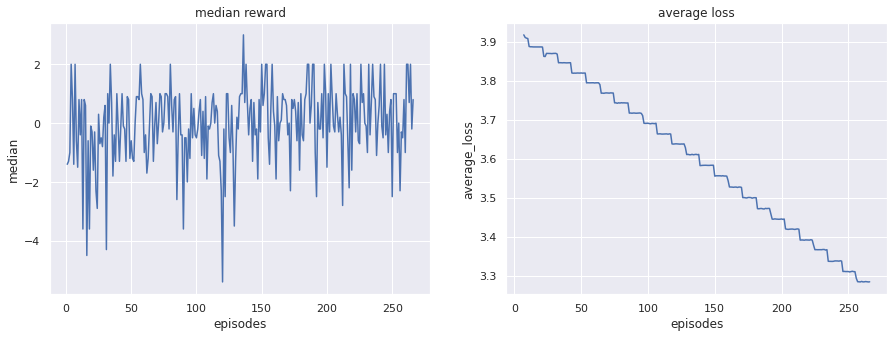

In [19]:
# visualize reward each episodes
fig = plt.figure(figsize=(15, 5))
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
ax1.set_title("median reward")
ax2.set_title("average loss")
sns.lineplot(x="episodes", y="median", data=scores, ax=ax1)
sns.lineplot(x="episodes", y="average_loss", data=scores,ax=ax2)
plt.show()

## Submission

To include pfrl library to submission file, I prepare pfrl repository.

In [20]:
# clone pfrl repo and move to the directory with main.py 
!git clone https://github.com/pfnet/pfrl.git
!mkdir sub
!mv ./pfrl/pfrl sub
!rm -r ./pfrl

Cloning into 'pfrl'...
remote: Enumerating objects: 15, done.
remote: Counting objects: 100% (15/15), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 2025 (delta 5), reused 6 (delta 3), pack-reused 2010
Receiving objects: 100% (2025/2025), 14.95 MiB | 18.95 MiB/s, done.
Resolving deltas: 100% (1223/1223), done.


To concat pfrl module and model weight to submission file, I use `stickytape` module.  
  
I refered [this topic](https://www.kaggle.com/c/halite/discussion/164005) in halite competition.Thanks [@higepon](https://www.kaggle.com/higepon).

First, I encode model weight to .py script by using base64. 

In [21]:
import base64

with open(f'./{num_steps}_finish/model.pt', 'rb') as f:
    encoded_string = base64.b64encode(f.read())

with open('./sub/model_weights.py', 'w') as f:
    f.write(f'model_string={encoded_string}')

In [22]:
%cd sub
!ls -la 

/kaggle/working/sub
total 39340
drwxr-xr-x  3 root root     4096 Nov 23 04:50 .
drwxr-xr-x 13 root root     4096 Nov 23 04:49 ..
-rw-r--r--  1 root root 40270204 Nov 23 04:50 model_weights.py
drwxr-xr-x 17 root root     4096 Nov 23 04:49 pfrl


Then, make main.py.  
  
I've been plagued with validation episode errors for a long time.  
Howerver it was solved by his advice. Thanks [@Tom Van de Wiele](https://www.kaggle.com/tvdwiele).

In [23]:
%%writefile main.py
import os
import sys
import cv2
import collections
import numpy as np
from gfootball.env import observation_preprocessing

# PFRL
import torch
import pfrl

import base64
from model_weights import model_string

def make_model():
    # Q_function
    model = pfrl.q_functions.DistributionalDuelingDQN(n_actions=19, n_atoms=51, v_min=-10, v_max=10, n_input_channels=4)
    
    # Noisy nets
    pfrl.nn.to_factorized_noisy(model, sigma_scale=0.5)
    
    # load weights
    with open("model.dat", "wb") as f:
        f.write(base64.b64decode(model_string))
    weights = torch.load("model.dat", map_location=torch.device('cpu'))
    model.load_state_dict(weights)
    return model


model = make_model()

def agent(obs):
    global model
    
    # Get observations for the first (and only one) player we control.
    obs = obs['players_raw'][0]
    # Agent we trained uses Super Mini Map (SMM) representation.
    # See https://github.com/google-research/seed_rl/blob/master/football/env.py for details.
    obs = observation_preprocessing.generate_smm([obs])[0]
    # preprocess for obs
    obs = cv2.resize(obs, (84,84))    # resize
    obs = np.transpose(obs, [2,0,1])  # transpose to chw
    obs = torch.tensor(obs).float()   # to tensor
    obs = torch.unsqueeze(obs,0)      # add batch

    actions = model(obs)
    action = int(actions.greedy_actions.numpy()[0])  # modified
    return [action]

Writing main.py


Finally I'll concat script file by using stickytape.  
main.py + pfrl library + model_weight.py => submission.py

In [24]:
!pip install stickytape

You should consider upgrading via the '/opt/conda/bin/python3.7 -m pip install --upgrade pip' command.


In [25]:
!stickytape main.py --add-python-path pfrl --add-python-path . > /kaggle/working/submission.py
!rm -r pfrl
%cd /kaggle/working
!ls -la

/kaggle/working
total 40304
drwxr-xr-x 13 root root     4096 Nov 23 04:50 .
drwxr-xr-x  6 root root     4096 Nov 22 21:08 ..
drwxr-xr-x  2 root root     4096 Nov 22 22:02 100000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 22 22:56 200000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 22 23:53 300000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 23 00:54 400000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 23 01:56 500000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 23 02:57 600000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 23 03:54 700000_checkpoint
drwxr-xr-x  2 root root     4096 Nov 23 04:49 800000_finish
----------  1 root root   274245 Nov 23 04:50 __notebook__.ipynb
drwxr-xr-x  2 root root     4096 Nov 22 21:10 best
drwxr-xr-x  5 root root     4096 Nov 22 21:08 football
-rw-r--r--  1 root root    67041 Nov 23 04:49 result.log
-rw-r--r--  1 root root    40569 Nov 23 04:49 scores.csv
-rw-r--r--  1 root root    40302 Nov 23 04:49 scores.txt
drwxr-xr-x  2 root root  

### check submission agent

In [26]:
from kaggle_environments import make
from submission import agent
env = make("football", configuration={"save_video": True, "scenario_name": "11_vs_11_kaggle", "running_in_notebook": True})
obs = env.state[0]["observation"]
action = agent(obs)
print(action)

[7]


In [27]:
from kaggle_environments import make
env = make("football", configuration={"save_video": True, "scenario_name": "11_vs_11_kaggle", "running_in_notebook": True}, debug=True)
agent = "submission.py"
output = env.run([agent, agent])[-1]
print('Left player: action = %s, reward = %s, status = %s, info = %s' % (output[0]["action"], output[0]['reward'], output[0]['status'], output[0]['info']))
print('Right player: action = %s, reward = %s, status = %s, info = %s' % (output[1]["action"], output[1]['reward'], output[1]['status'], output[1]['info']))
env.render(mode="human", width=800, height=600)

Staring a new environment b78f9047-8963-48f9-9ce8-bd16db4f5687: with scenario: 11_vs_11_kaggle
Resetting environment b78f9047-8963-48f9-9ce8-bd16db4f5687: with scenario: 11_vs_11_kaggle
Received video link.
Left player: action = [0], reward = 1, status = DONE, info = {}
Right player: action = [17], reward = -1, status = DONE, info = {}


In [28]:
# to clean output folder
!rm -r /kaggle/working/football
!rm -r /kaggle/working/kaggle-environments

rm: cannot remove '/kaggle/working/kaggle-environments': No such file or directory


### Submit to Competition
1. "Save & Run All" (commit) this Notebook
2. Go to the notebook viewer
3. Go to "Output" section and find submission.py file.
4. Click "Submit to Competition"

Go to My Submissions to view your score and episodes being played.  
Thank you.